# Making a GIF From Video Frames

## Setup

### Imports

In [1]:
from datetime import datetime
import os

import numpy as np
import pandas as pd
import skimage.io
import skimage.transform

### Loading Geodata

In [2]:
geodata_path = 'data/parler-videos-geocoded.csv'

df_geodata = pd.read_csv(geodata_path)
df_geodata = df_geodata.set_index('ID')
df_geodata['images'] = [[] for _ in range(len(df_geodata))]
df_geodata.head()

,Longitude,Latitude,Timestamp,images
ID,,,,
PtowPIzpewhu,0.0000,0.0000,2010-08-08 21:44:38,[]
dGOhNqNgNywF,0.0000,0.0000,2011-03-19 16:48:35,[]
RGTLwBQugFNU,-118.8878,39.5554,2011-08-01 22:22:40,[]
YNBV5GZkeM2E,-74.6049,39.3308,2011-11-11 21:36:54,[]
oqLyjjYghOMi,-101.8747,33.4269,2012-12-24 22:50:15,[]


In [3]:
'PtowPIzpewhu' in df_geodata.index

True

In [4]:
df_geodata.loc['PtowPIzpewhu']['images']

[]

## Parsing Frames

Making all frames have similar aspect ratios.

### Mapping IDs to Timestamps and Locations

In [5]:
base_path = './data/frames/'
video_subfolders = [p for p in os.listdir(base_path) if p[0] != '.']

print(video_subfolders)

['2627', '2425', '67', '2829', '4445', '3031', '4849', '3233', '4647', '1213', '89', '45', '1011', '2021', '2223', '01', '3637', '4243', '4041', '3435', '3839', '1415', '23', '1819', '1617']


In [6]:
images_added = 0

for directory in video_subfolders:
    path = os.path.join(base_path, directory)
    images = [p for p in os.listdir(path) if len(p) > 4 and p[-4:] == '.jpg']
    for img in images:
        video_id = img.split('.')[0]
        
        if video_id in df_geodata.index:
            img_path = os.path.join(path, img)
            df_geodata.loc[video_id]['images'].append(img_path)
            images_added += 1
            
print(images_added)

1785


### Capitol Attack Images

In [7]:
df = df_geodata[df_geodata['images'].apply(lambda x: len(x) > 0)]
df['Timestamp'] = [datetime.fromisoformat(x) for x in df.loc[:, 'Timestamp'].tolist()]
df = df[df['Timestamp'].dt.hour >= 12]
df = df.set_index('Timestamp')

print(len(df))
df.head()

547


<ipython-input-7-8217e6333375>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Timestamp'] = [datetime.fromisoformat(x) for x in df.loc[:, 'Timestamp'].tolist()]


,Longitude,Latitude,images
Timestamp,,,
2021-01-06 12:00:15,-77.0195,38.8888,"[./data/frames/45/vgvvmX00Bf4f.mp4_60.jpg, ./d..."
2021-01-06 12:06:33,-77.1115,38.8820,"[./data/frames/45/R5xQ2bIblPBk.mp4_29.jpg, ./d..."
2021-01-06 12:22:20,-77.0366,38.8919,"[./data/frames/45/S0RLaNltewMK.mp4_60.jpg, ./d..."
2021-01-06 12:38:55,-77.0302,38.8959,"[./data/frames/45/zvhAF87Dreod.mp4_0.jpg, ./da..."
2021-01-06 12:51:45,-77.0368,38.8921,"[./data/frames/45/2fqpw5l9SeIl.mp4_29.jpg, ./d..."


In [8]:
df.tail()

,Longitude,Latitude,images
Timestamp,,,
2021-01-06 19:03:52,-77.0179,38.8899,"[./data/frames/4849/I9VWJlj35vcy.mp4_58.jpg, ...."
2021-01-06 19:03:57,-77.0144,38.8897,"[./data/frames/4849/Cc1sJwp9vtSG.mp4_120.jpg, ..."
2021-01-06 19:03:59,-77.0102,38.8901,"[./data/frames/4849/70PxGZN8jdkz.mp4_60.jpg, ...."
2021-01-06 19:03:59,-77.0102,38.8901,"[./data/frames/4849/7dlSyXDWtlyA.mp4_30.jpg, ...."
2021-01-06 19:03:59,-77.0102,38.8901,"[./data/frames/4849/ViIpu8eZLGaK.mp4_60.jpg, ...."


### Choosing Images

We take the last image captured from the video, as it is the most likely to contain good information. We only do so for images between 10am and 6pm.

In [9]:
import matplotlib.pyplot as plt

In [10]:
vertical_images = []
horizontal_images = []

def todigit(s):
    last_part = s.split('_')[-1]
    return int(last_part.split('.')[0])

for idx, row in df.iterrows():
    images = sorted(row['images'], key=lambda x: -todigit(x))
    img = skimage.io.imread(images[0])
    h, w, _ = img.shape
    aspect_ratio = h/w
    
    if aspect_ratio > 1.5:
        vertical_images.append((idx, images[0], img))
    elif aspect_ratio < (2/3):
        horizontal_images.append((idx, images[0], img))

In [11]:
print(len(vertical_images), len(horizontal_images))

347 198


In [12]:
resized_vertical_images = [
    (timestamp, url, skimage.transform.resize(img, (600, 400), anti_aliasing=True))
    for (timestamp, url, img) in vertical_images
]

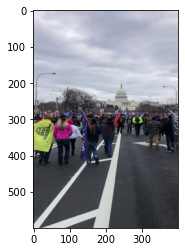

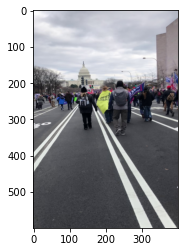

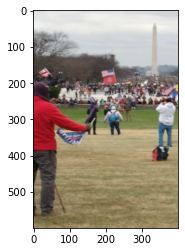

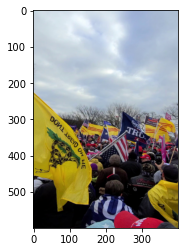

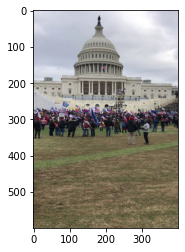

...

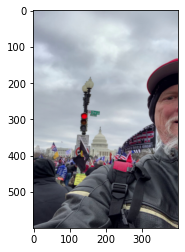

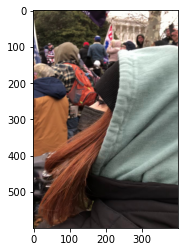

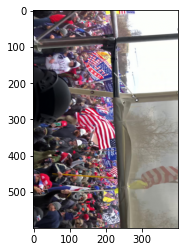

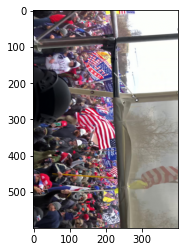

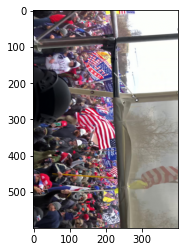

In [13]:
for (t, url, img) in resized_vertical_images[-100:]:
    plt.imshow(img)
    plt.show()

In [14]:
resized_horizontal_images = [
    (timestamp, url, skimage.transform.resize(img, (400, 600), anti_aliasing=True))
    for (timestamp, url, img) in horizontal_images
]

In [21]:
h_selection = [0, 1, 2, 7, 8, 9, 10, 14, 15, 17, 19, 
              20, 22, 24, 26, 27, 29, 30, 31, 34, 50, 58,
              61, 62, 72, 78, 86, 87, 105, 107, 109, 128,
               129, 130, 131, 133, 139, 141, 148, 150,
              151, 154, 155, 156, 157, 159, 161, 165, 
              174, 178, 179, 182, 184, 194, 196]

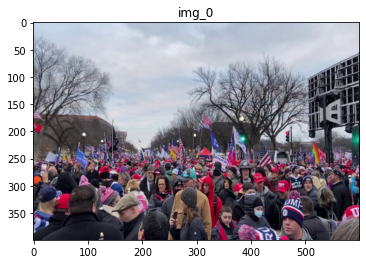

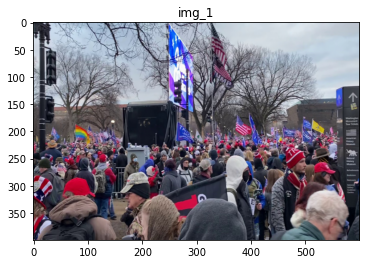

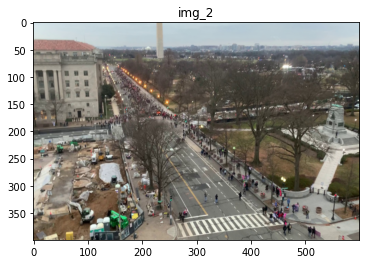

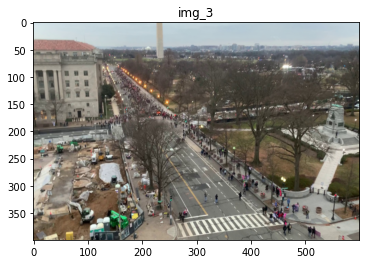

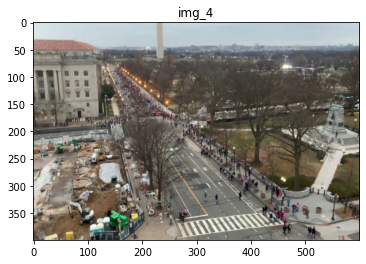

...

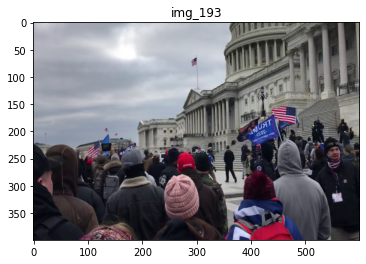

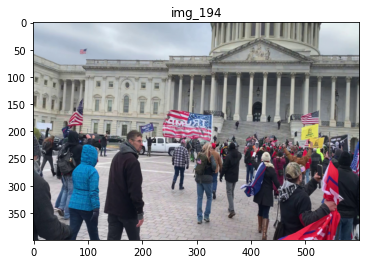

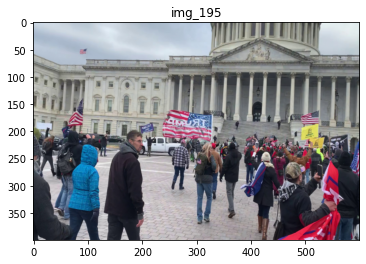

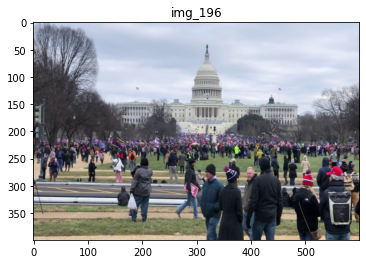

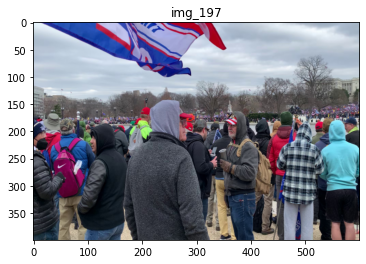

In [20]:
for i, (t, url, img) in enumerate(resized_horizontal_images):
    plt.title(f'img_{i}')
    plt.imshow(img)
    plt.show()

In [17]:
for i, (tstamp, url, img) in enumerate(resized_vertical_images):
    skimage.io.imsave(f'vertical_image_{i}.jpg', img)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


In [18]:
for i, (tstamp, url, img) in enumerate(resized_horizontal_images):
    skimage.io.imsave(f'horizontal_image_{i}.jpg', img)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

In [22]:
for i, (tstamp, url, img) in enumerate(resized_horizontal_images):
    if i in h_selection:
        skimage.io.imsave(f'h_select/img_{i:03}.jpg', img)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Creating the GIF

In [26]:
import glob
from PIL import Image

# filepaths
fp_in = "./h_select/*.jpg"


if __name__ == '__main__':
    fp_out = "vertical_long.gif"
    img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]


    img.save(fp=fp_out, format='GIF', append_images=imgs,
             save_all=True, duration=500, disposal=2, loop=0)